![S Legend](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSTwIpP7v3ycNMnjghyjhgmuA91On6Ylqd3BA&s)

# Team S Legend

In [6]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler

import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
raw_data = pd.read_csv('Life Expectancy Data.csv')

In [8]:
raw_data.head()

,Country,Region,Year,Infant_deaths,Under_five_deaths,Adult_mortality,Alcohol_consumption,Hepatitis_B,Measles,BMI,...,Diphtheria,Incidents_HIV,GDP_per_capita,Population_mln,Thinness_ten_nineteen_years,Thinness_five_nine_years,Schooling,Economy_status_Developed,Economy_status_Developing,Life_expectancy
0,Turkiye,Middle East,2015,11.1,13.0,105.8240,1.32,97,65,27.8,...,97,0.08,11006,78.53,4.9,4.8,7.8,0,1,76.5
1,Spain,European Union,2015,2.7,3.3,57.9025,10.35,97,94,26.0,...,97,0.09,25742,46.44,0.6,0.5,9.7,1,0,82.8
2,India,Asia,2007,51.5,67.9,201.0765,1.57,60,35,21.2,...,64,0.13,1076,1183.21,27.1,28.0,5.0,0,1,65.4
3,Guyana,South America,2006,32.8,40.5,222.1965,5.68,93,74,25.3,...,93,0.79,4146,0.75,5.7,5.5,7.9,0,1,67.0
4,Israel,Middle East,2012,3.4,4.3,57.9510,2.89,97,89,27.0,...,94,0.08,33995,7.91,1.2,1.1,12.8,1,0,81.7


In [9]:
raw_data.shape

(2864, 21)

In [10]:
raw_data.isnull().sum()

Country                        0
Region                         0
Year                           0
Infant_deaths                  0
Under_five_deaths              0
Adult_mortality                0
Alcohol_consumption            0
Hepatitis_B                    0
Measles                        0
BMI                            0
Polio                          0
Diphtheria                     0
Incidents_HIV                  0
GDP_per_capita                 0
Population_mln                 0
Thinness_ten_nineteen_years    0
Thinness_five_nine_years       0
Schooling                      0
Economy_status_Developed       0
Economy_status_Developing      0
Life_expectancy                0
dtype: int64

In [11]:
raw_data.dtypes

Country                         object
Region                          object
Year                             int64
Infant_deaths                  float64
Under_five_deaths              float64
Adult_mortality                float64
Alcohol_consumption            float64
Hepatitis_B                      int64
Measles                          int64
BMI                            float64
Polio                            int64
Diphtheria                       int64
Incidents_HIV                  float64
GDP_per_capita                   int64
Population_mln                 float64
Thinness_ten_nineteen_years    float64
Thinness_five_nine_years       float64
Schooling                      float64
Economy_status_Developed         int64
Economy_status_Developing        int64
Life_expectancy                float64
dtype: object

In [12]:
raw_data.Region = raw_data.Region.astype('category')

In [13]:
raw_data.Region.unique()

['Middle East', 'European Union', 'Asia', 'South America', 'Central America and Caribbean', 'Rest of Europe', 'Africa', 'Oceania', 'North America']
Categories (9, object): ['Africa', 'Asia', 'Central America and Caribbean', 'European Union', ..., 'North America', 'Oceania', 'Rest of Europe', 'South America']

In [14]:
raw_data.Country = raw_data.Country.astype('category')

In [15]:
raw_data=raw_data.sort_values(by=['Country', 'Year']).reset_index(drop=True)

In [16]:
raw_data['Year']

0       2000
1       2001
2       2002
3       2003
4       2004
        ... 
2859    2011
2860    2012
2861    2013
2862    2014
2863    2015
Name: Year, Length: 2864, dtype: int64

In [17]:
years_required = set(raw_data.Year)

missing_years_countries = raw_data.groupby('Country').filter(
    lambda x: set(x['Year']) != years_required
)['Country']


C:\Users\mpjau\AppData\Local\Temp\ipykernel_16928\3956474153.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  missing_years_countries = raw_data.groupby('Country').filter(


In [18]:
missing_years_countries

Series([], Name: Country, dtype: category
Categories (179, object): ['Afghanistan', 'Albania', 'Algeria', 'Angola', ..., 'Vietnam', 'Yemen, Rep.', 'Zambia', 'Zimbabwe'])

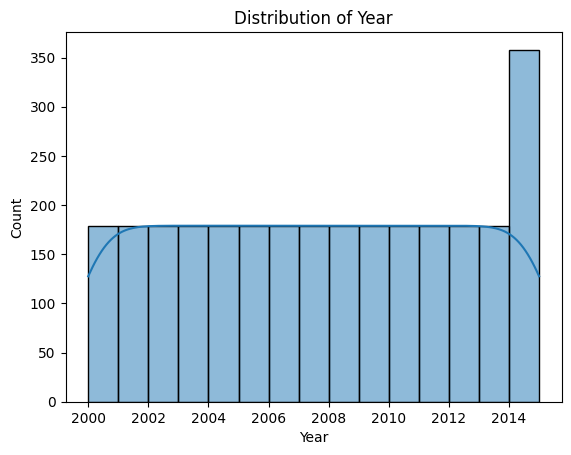

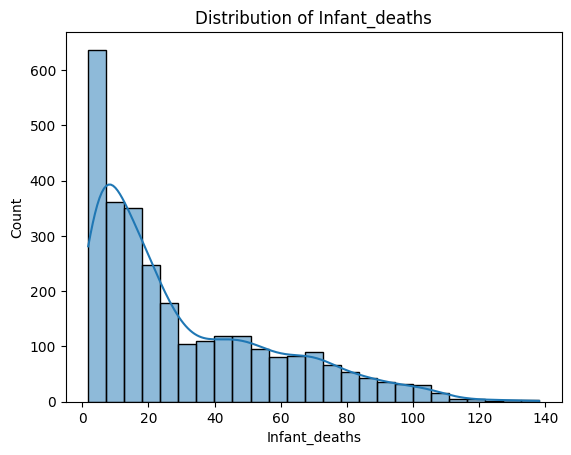

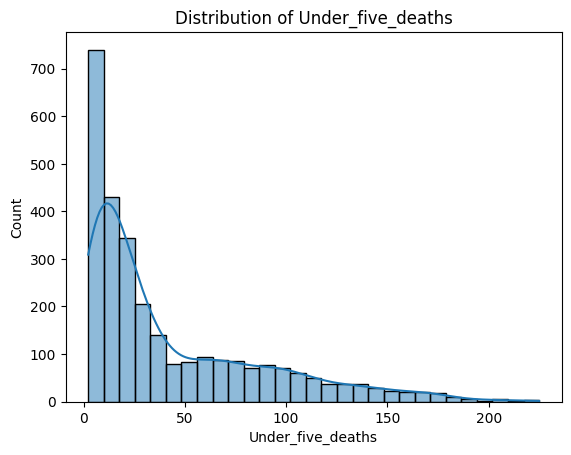

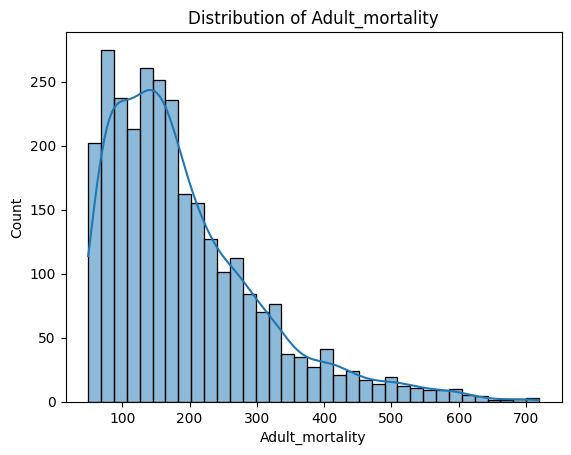

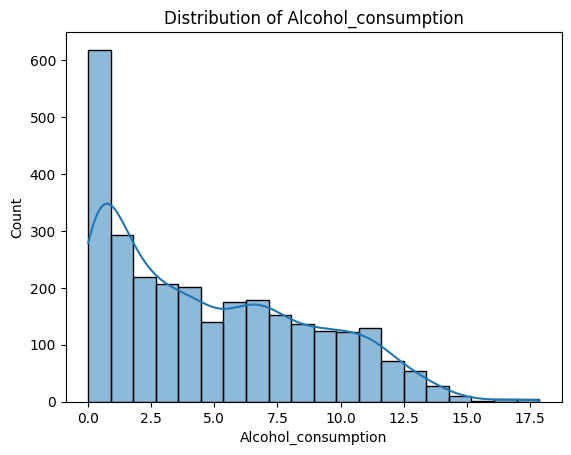

...

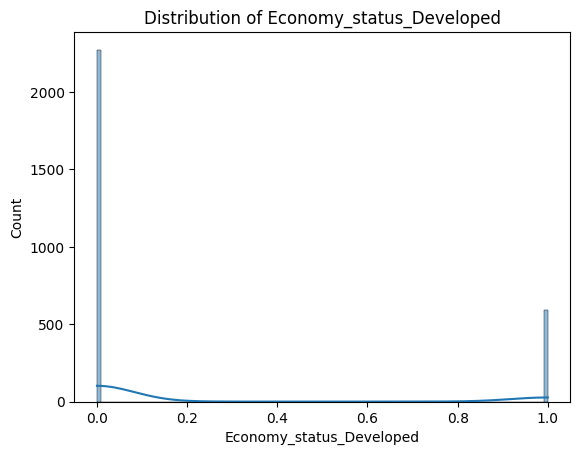

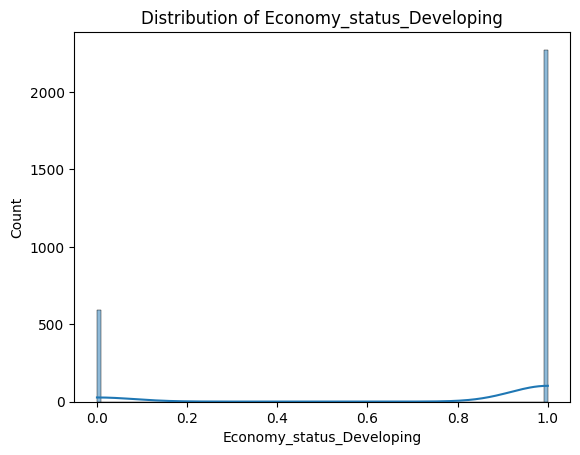

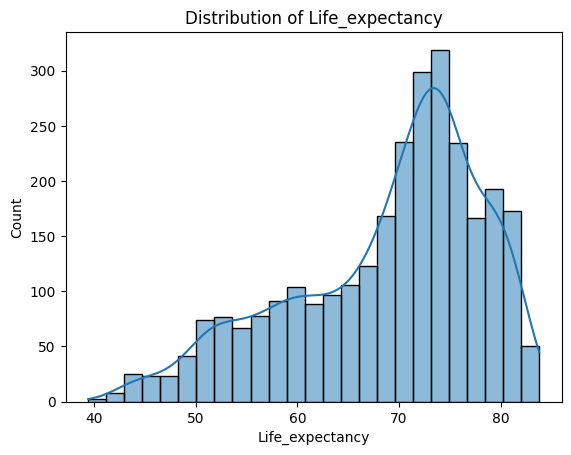

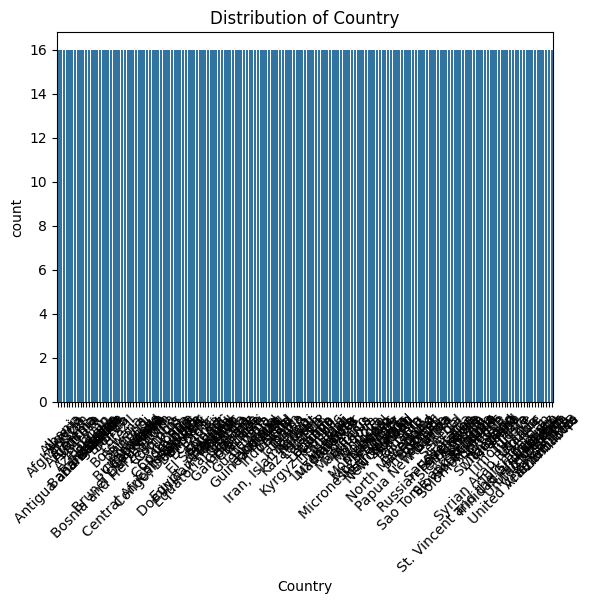

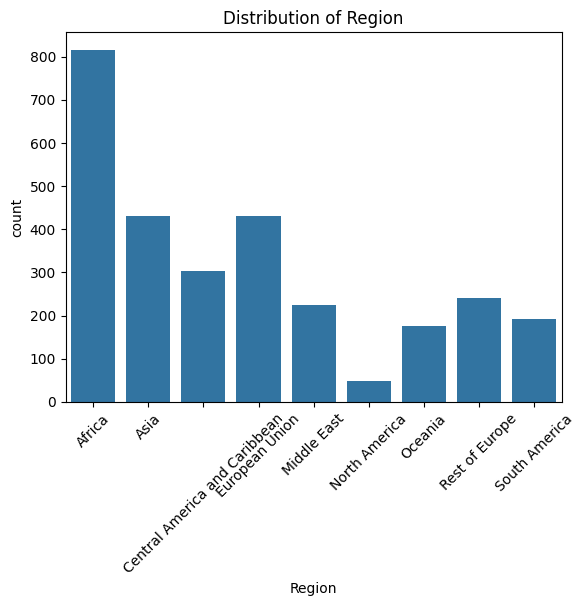

In [19]:
for col in raw_data.select_dtypes(include='number').columns:
    sns.histplot(data=raw_data, x=col, kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

for col in raw_data.select_dtypes(include='category').columns:
    sns.countplot(data=raw_data, x=col)
    plt.title(f'Distribution of {col}')
    plt.xticks(rotation=45)
    plt.show()

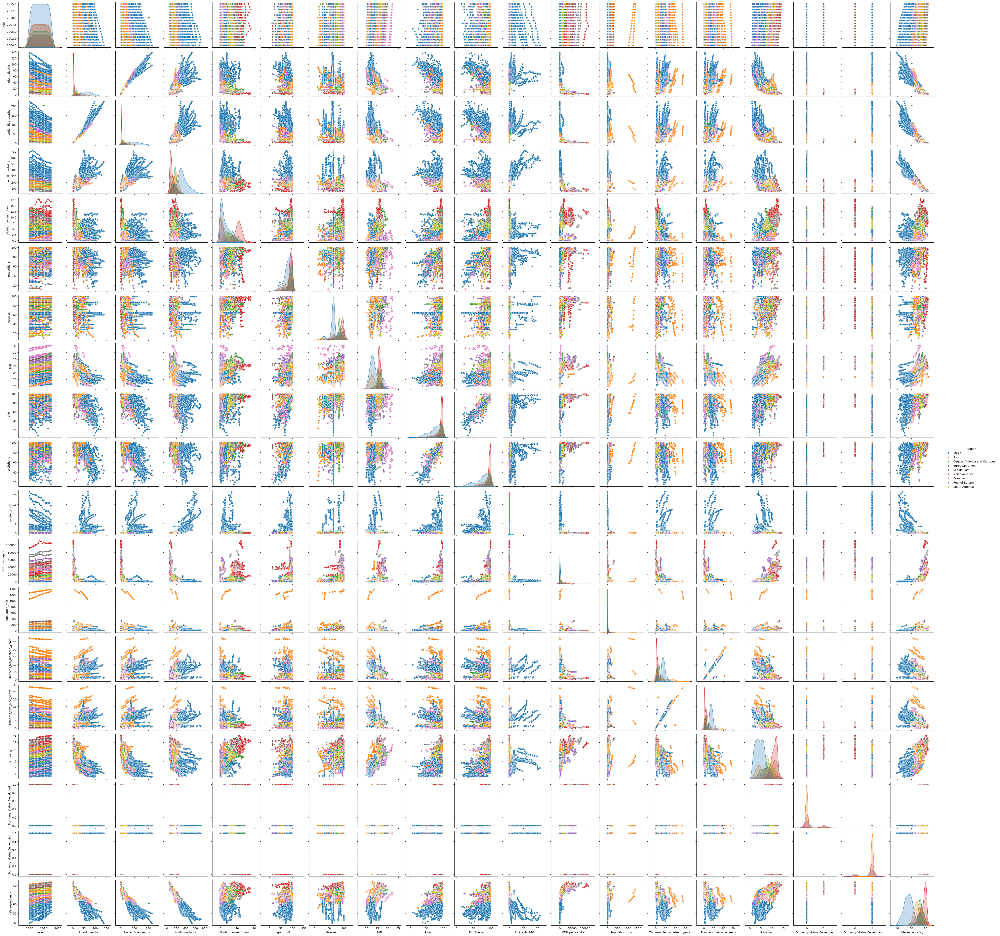

In [70]:
sns.pairplot(raw_data, hue='Region', diag_kind='kde')

Split into Test and Train

In [21]:
X = raw_data.drop(columns=['Life_expectancy'])
y = raw_data['Life_expectancy']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [22]:
X_train.columns

Index(['Country', 'Region', 'Year', 'Infant_deaths', 'Under_five_deaths',
       'Adult_mortality', 'Alcohol_consumption', 'Hepatitis_B', 'Measles',
       'BMI', 'Polio', 'Diphtheria', 'Incidents_HIV', 'GDP_per_capita',
       'Population_mln', 'Thinness_ten_nineteen_years',
       'Thinness_five_nine_years', 'Schooling', 'Economy_status_Developed',
       'Economy_status_Developing'],
      dtype='object')

In [23]:
def feat_eng(df):
    df = df.copy()
    df = pd.get_dummies(df, columns = ['Region'], drop_first=True, dtype=int)
    df = pd.get_dummies(df, columns = ['Country'], drop_first=True, dtype=int)
    df = sm.add_constant(df, has_constant='add')
    return df

In [24]:
X_train_fe = feat_eng(X_train)

In [25]:
lin_reg = sm.OLS(y_train, X_train_fe)

lin_reg_result = lin_reg.fit()
lin_reg_result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        Life_expectancy   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                     4349.
Date:                Thu, 10 Jul 2025   Prob (F-statistic):               0.00
Time:                        09:27:58   Log-Likelihood:                -1509.9
No. Observations:                2291   AIC:                             3410.
Df Residuals:                    2096   BIC:                             4528.
Df Model:                         194                                         
Covariance Type:            nonrobust                                         
==========================================================================================================
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                   -139.8310      9.167    -15.254      0.000    -157.807    -121.854
Year                                       0.1518      0.008     19.716      0.000       0.137       0.167
Infant_deaths                             -0.0096      0.008     -1.209      0.227      -0.025       0.006
Under_five_deaths                         -0.0411      0.004     -9.787      0.000      -0.049      -0.033
Adult_mortality                           -0.0431      0.001    -56.606      0.000      -0.045      -0.042
Alcohol_consumption                       -0.0321      0.013     -2.411      0.016      -0.058      -0.006
Hepatitis_B                                0.0016      0.002      0.977      0.329      -0.002       0.005
Measles                                    0.0031      0.002      1.979      0.048     2.9e-05       0.006
BMI                                       -0.4580      0.073     -6.295      0.000      -0.601      -0.315
Polio                                      0.0026      0.003      0.821      0.412      -0.004       0.009
Diphtheria                                 0.0075      0.003      2.304      0.021       0.001       0.014
Incidents_HIV                              0.1706      0.028      6.053      0.000       0.115       0.226
GDP_per_capita                           2.62e-05   6.96e-06      3.767      0.000    1.26e-05    3.98e-05
Population_mln                             0.0007      0.002      0.467      0.641      -0.002       0.004
Thinness_ten_nineteen_years               -0.0088      0.008     -1.066      0.287      -0.025       0.007
Thinness_five_nine_years                  -0.0129      0.008     -1.573      0.116      -0.029       0.003
Schooling                                 -0.1558      0.033     -4.769      0.000      -0.220      -0.092
Economy_status_Developed                 -63.6125      4.247    -14.979      0.000     -71.941     -55.284
Economy_status_Developing                -76.2184      4.923    -15.481      0.000     -85.874     -66.563
Region_Asia                               -2.5667      0.296     -8.671      0.000      -3.147      -1.986
Region_Central America and Caribbean       3.7295      0.131     28.483      0.000       3.473       3.986
Region_European Union                     -6.7128      0.513    -13.081      0.000      -7.719      -5.706
Region_Middle East                         1.8617      0.171     10.906      0.000       1.527       2.196
Region_North America                      -1.6414      0.213     -7.705      0.000      -2.059      -1.224
Region_Oceania                            -0.5025      0.143     -3.502      0.000      -0.784      -0.221
Region_Rest of Europe                      0.8822      0.116      7.626      0.000     

In [26]:
y_pred = lin_reg_result.predict(X_train_fe)

import statsmodels.tools.eval_measures
rmse = statsmodels.tools.eval_measures.rmse(y_train, y_pred)

print(rmse)

0.4677191628978448


In [27]:
X_test_fe = feat_eng(X_test)

print(X_train_fe.shape, X_test_fe.shape)

(2291, 205) (573, 205)


In [28]:
y_test_pred = lin_reg_result.predict(X_test_fe)
rmse = statsmodels.tools.eval_measures.rmse(y_test, y_test_pred)
print(rmse)

0.5021307441275692


This set a benchmark of where we should aim to be within.

This obviously not a great model with a condition number of order to the 20, hence extremly unstable.
Now need to look at what is contributing to multicolinearity and what can we afford to get rid of without sacrificing too much RMSE.


Lets look to see how pracitcal it is to model per country.

For entire dataset:

In [29]:
raw_data.groupby('Region').count()

C:\Users\mpjau\AppData\Local\Temp\ipykernel_16928\3104699633.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  raw_data.groupby('Region').count()


,Country,Year,Infant_deaths,Under_five_deaths,Adult_mortality,Alcohol_consumption,Hepatitis_B,Measles,BMI,Polio,Diphtheria,Incidents_HIV,GDP_per_capita,Population_mln,Thinness_ten_nineteen_years,Thinness_five_nine_years,Schooling,Economy_status_Developed,Economy_status_Developing,Life_expectancy
Region,,,,,,,,,,,,,,,,,,,,
Africa,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816,816
Asia,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432
Central America and Caribbean,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304,304
European Union,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432,432
Middle East,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224,224
North America,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48
Oceania,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176,176
Rest of Europe,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240,240
South America,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192,192


Looks as if there is a decent amount of data per region except from America. How sensible is this to put together?

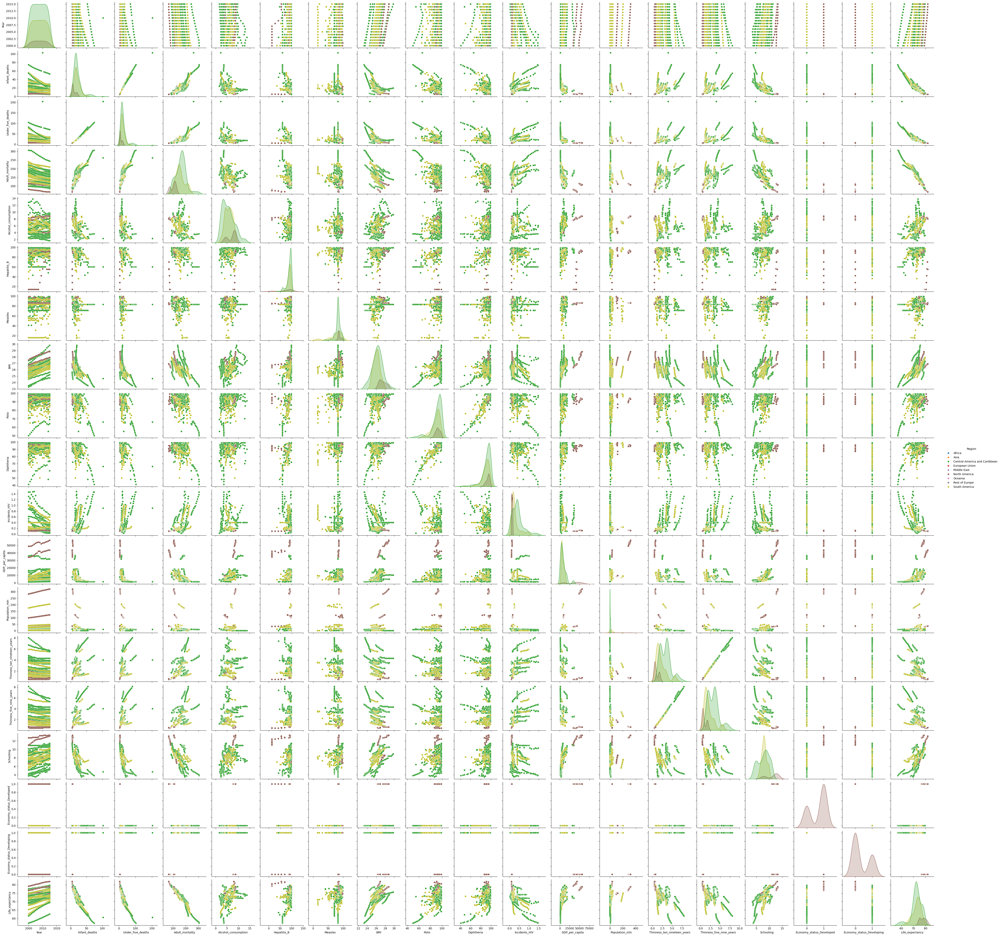

In [30]:
regions_to_plot = ['North America', 'Central America and Caribbean', 'South America']
filtered_data = raw_data[raw_data['Region'].isin(regions_to_plot)]

sns.pairplot(filtered_data, hue='Region', diag_kind='kde')

America seems distinctively seperate so to group as one region would loose alot of accuracy.

Is log transformation beneficial?

<Axes: >

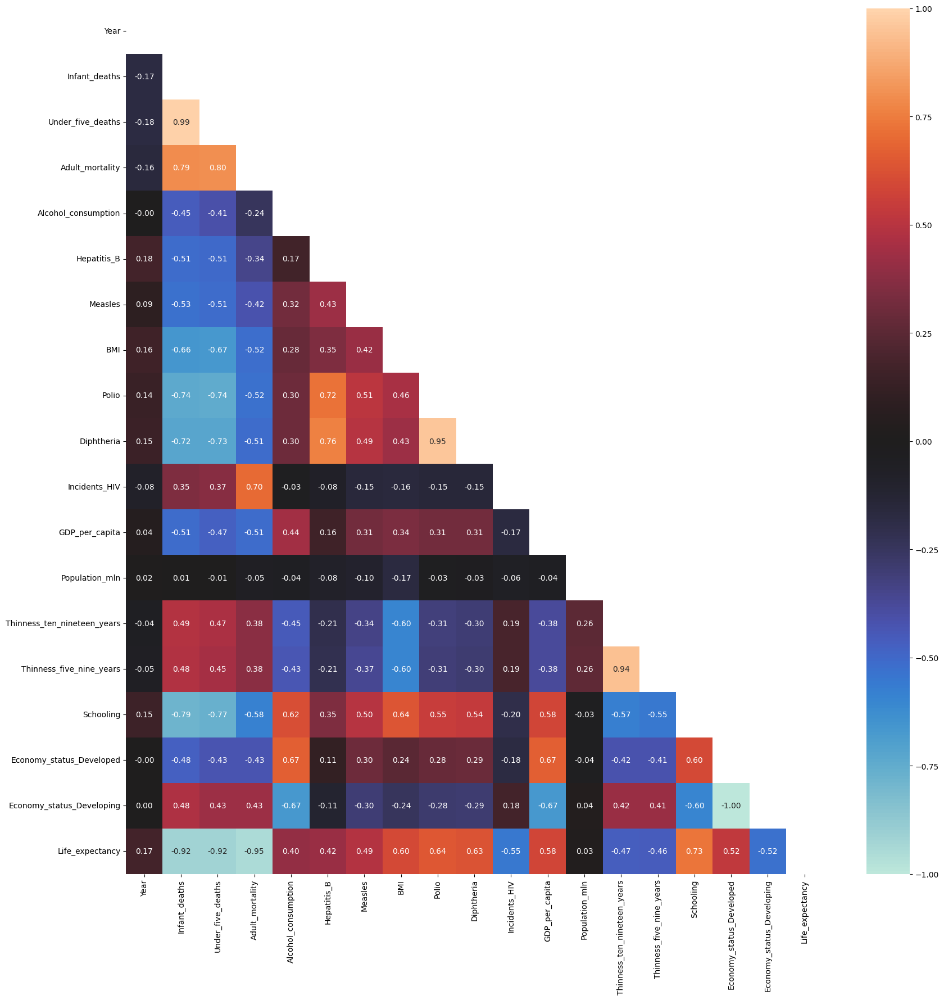

In [31]:

corr = raw_data.select_dtypes(include='number').corr()

matrix = np.triu(corr)
plt.figure(figsize=(20, 20))
sns.heatmap(corr,
            vmin = -1, vmax = 1, center = 0,
            annot = True, fmt = '.2f', mask=matrix,)

In [32]:
log_data = raw_data.copy()
for col in log_data.select_dtypes(include='number').columns:
    if col == 'Life_expectancy':
        continue
    log_data[col] = np.log1p(log_data[col])

logcorr = log_data.select_dtypes(include='number').corr()

Text(0.5, 1.0, 'Absolute Correlation')

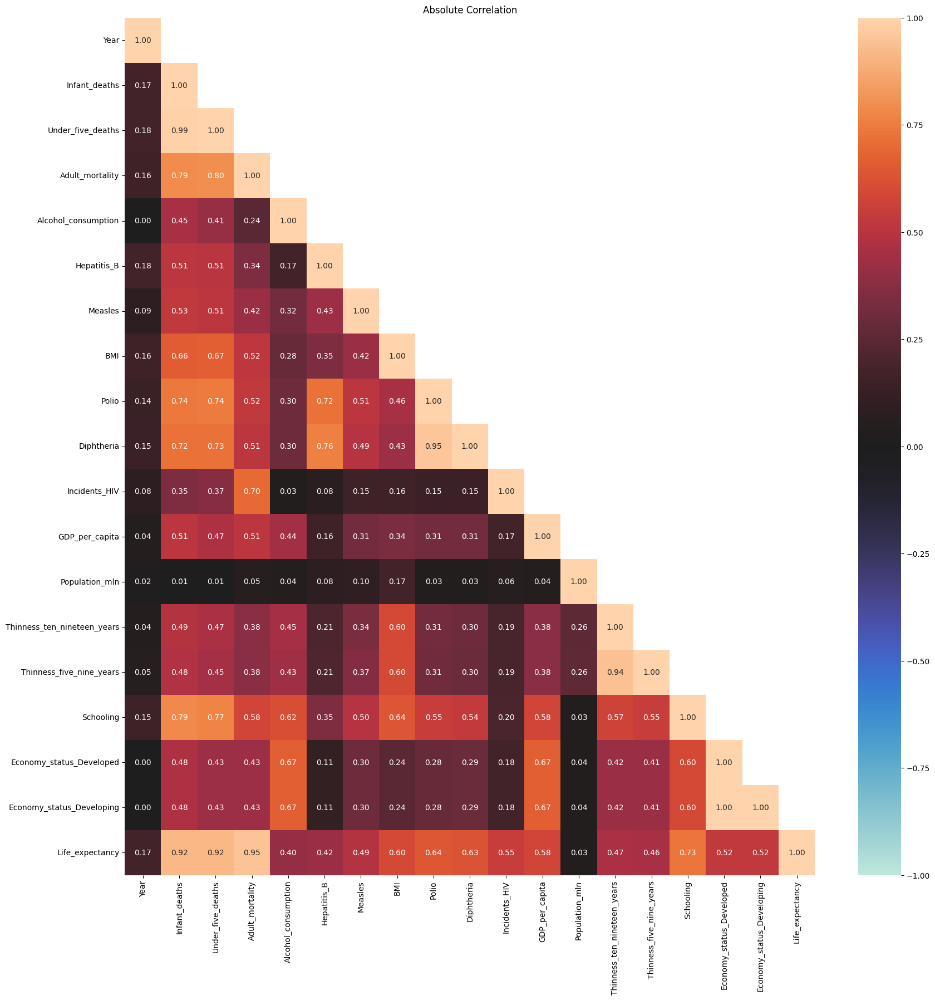

In [73]:
abscorr = corr.abs()
abslogcorr = logcorr.abs()
diffcorr = abscorr - abslogcorr

matrix = np.triu(diffcorr)
plt.figure(figsize=(20, 20))
sns.heatmap(abscorr,
            vmin = -1, vmax = 1, center = 0,
            annot = True, fmt = '.2f', mask=matrix)
plt.title('Absolute Correlation')

NOTES FROM THIS:

-Drop Population_mln

-Drop Year


-Log GDP -> Drop Economystatus(both), Drop Schooling, Drop thinness (both)

-Log HIV Inciddents

-Keep Alc consumption -> Drop infant and under five deaths

-Keep BMI

In [ ]:
def feat_engV2(df):
    df = df.copy()
    scaler = StandardScaler()
    
    df = pd.get_dummies(df, columns = ['Region'], drop_first=True, dtype=int)
    #df = pd.get_dummies(df, columns = ['Country'], drop_first=True, dtype=int)

    df=df.drop(columns=['Country'])

    df = df.drop(columns=['Year', 'Population_mln', 'Economy_status_Developed', 'Economy_status_Developing', 'Thinness_ten_nineteen_years', 'Thinness_five_nine_years', 'Diphtheria', 'Hepatitis_B', 'Infant_deaths', 'Under_five_deaths', 'Schooling'])  

    df['GDP_per_capita'] = np.log1p(df['GDP_per_capita'])
    df['Incidents_HIV'] = np.log1p(df['Incidents_HIV'])

    df_scaled = pd.DataFrame(
    scaler.fit_transform(df),
    columns=df.columns,
    index=df.index)  

    print(df_scaled.columns)

    df_scaled = sm.add_constant(df, has_constant='add')
    return df_scaled

In [91]:
def run_model(X_train, y_train):
    X_train_fe = feat_engV2(X_train)
    lin_reg = sm.OLS(y_train, X_train_fe)
    lin_reg_result = lin_reg.fit()
    return lin_reg_result, lin_reg

In [92]:
def RMSE_calc(y, X_train, model):
    X_feateng = feat_engV2(X_train)
    y_pred = model.predict(X_feateng)
    rmse = statsmodels.tools.eval_measures.rmse(y, y_pred)
    return rmse

In [93]:
def calc_VIF(X_train):
    X_train_fe = feat_engV2(X_train)

    if isinstance(X_train_fe, np.ndarray):
        X_train_fe = pd.DataFrame(X_train_fe, index=X_train.index)

    vif_data = pd.DataFrame()
    vif_data['feature'] = X_train_fe.columns
    vif_data['VIF'] = [variance_inflation_factor(X_train_fe.values, i) for i in range(X_train_fe.shape[1])]
    return vif_data

In [94]:
lin_reg_resultV2, lin_reg_V2 = run_model(X_train, y_train)
lin_reg_resultV2.summary()

Index(['Alcohol_consumption', 'Measles', 'BMI', 'Polio', 'Incidents_HIV',
       'GDP_per_capita', 'Region_Asia', 'Region_Central America and Caribbean',
       'Region_European Union', 'Region_Middle East', 'Region_North America',
       'Region_Oceania', 'Region_Rest of Europe', 'Region_South America'],
      dtype='object')


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        Life_expectancy   R-squared:                       0.899
Model:                            OLS   Adj. R-squared:                  0.899
Method:                 Least Squares   F-statistic:                     1451.
Date:                Thu, 10 Jul 2025   Prob (F-statistic):               0.00
Time:                        10:04:23   Log-Likelihood:                -5754.2
No. Observations:                2291   AIC:                         1.154e+04
Df Residuals:                    2276   BIC:                         1.162e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   29.2114      0.969     30.142      0.000      27.311      31.112
Alcohol_consumption                     -0.1334      0.028     -4.778      0.000      -0.188      -0.079
Measles                                 -0.0138      0.004     -3.238      0.001      -0.022      -0.005
BMI                                      0.0872      0.048      1.817      0.069      -0.007       0.181
Polio                                    0.1432      0.006     26.038      0.000       0.132       0.154
Incidents_HIV                           -6.4192      0.153    -41.935      0.000      -6.719      -6.119
GDP_per_capita                           3.2386      0.075     43.387      0.000       3.092       3.385
Region_Asia                              2.2525      0.245      9.207      0.000       1.773       2.732
Region_Central America and Caribbean     4.0456      0.289     14.003      0.000       3.479       4.612
Region_European Union                    3.2410      0.358      9.049      0.000       2.539       3.943
Region_Middle East                       1.1053      0.343      3.225      0.001       0.433       1.777
Region_North America                     2.8563      0.540      5.289      0.000       1.797       3.915
Region_Oceania                           1.6289      0.358      4.549      0.000       0.927       2.331
Region_Rest of Europe                    3.7199      0.336     11.079      0.000       3.061       4.378
Region_South America                     3.4576      0.330     10.488      0.000       2.811       4.104
==============================================================================
Omnibus:                       19.564   Durbin-Watson:                   1.991
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               29.776
Skew:                          -0.027   Prob(JB):                     3.42e-07
Kurtosis:                       3.556   Cond. No.                     2.01e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.01e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [95]:
RMSE_calc(y_train, X_train, lin_reg_resultV2)

Index(['Alcohol_consumption', 'Measles', 'BMI', 'Polio', 'Incidents_HIV',
       'GDP_per_capita', 'Region_Asia', 'Region_Central America and Caribbean',
       'Region_European Union', 'Region_Middle East', 'Region_North America',
       'Region_Oceania', 'Region_Rest of Europe', 'Region_South America'],
      dtype='object')


np.float64(2.982390925111404)

In [96]:
RMSE_calc(y_test, X_test, lin_reg_resultV2)

Index(['Alcohol_consumption', 'Measles', 'BMI', 'Polio', 'Incidents_HIV',
       'GDP_per_capita', 'Region_Asia', 'Region_Central America and Caribbean',
       'Region_European Union', 'Region_Middle East', 'Region_North America',
       'Region_Oceania', 'Region_Rest of Europe', 'Region_South America'],
      dtype='object')


np.float64(3.2871332070079697)

In [89]:
calc_VIF(X_train)

,feature,VIF
0,const,326.459957
1,Adult_mortality,3.047693
2,Alcohol_consumption,3.292185
3,Measles,1.614809
4,BMI,2.782534
5,Polio,1.791940
6,GDP_per_capita,3.667710
7,Region_Asia,1.787558
8,Region_Central America and Caribbean,1.950246
9,Region_European Union,3.890416
